<a href="https://colab.research.google.com/github/TahminaAnondi/asthmaandcopd/blob/main/Copy_of_Conference.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Import Libraries
import tensorflow as tf
import numpy as np #Linear Algebra
import matplotlib.pyplot as plt #Data visualization
import pandas as pd #data manipulation

import warnings
warnings.filterwarnings('ignore') #Ignore warnings

#Make sure Tensorflow is version 2.0 or higher
print('Tensorflow Version:', tf.__version__)

Tensorflow Version: 2.15.0


In [ ]:
file_path = "/content/Annual_Pm2.5_Asthma_Copd_All_State.csv"
data = pd.read_csv(file_path)

In [ ]:
# Set 'CountyFips_Year' as the index
data.set_index('CountyFips_Year', inplace=True)

In [ ]:
# Split the data into training (2001-2019) and testing (2020)
training_data = data[data['Year'] < 2020]
testing_data = data[data['Year'] == 2020]


In [ ]:
# Prepare the dictionaries with the training data
pm25_dict_training = {
    'Index': training_data.index,
    'pm25': training_data['PM2.5'].tolist()
}

asthma_dict_training = {
    'Index': training_data.index,
    'asthma': training_data['Asthma'].tolist()
}

copd_dict_training = {
    'Index': training_data.index,
    'copd': training_data['COPD'].tolist()
}

# Prepare the dictionaries with the testing data
pm25_dict_testing = {
    'Index': testing_data.index,
    'pm25': testing_data['PM2.5'].tolist()
}

asthma_dict_testing = {
    'Index': testing_data.index,
    'asthma': testing_data['Asthma'].tolist()
}

copd_dict_testing = {
    'Index': testing_data.index,
    'copd': testing_data['COPD'].tolist()
}


In [ ]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go

file_path = "/content/Annual_Pm2.5_Asthma_Copd_All_State.csv"
data = pd.read_csv(file_path)



# Replace 'Suppressed', '^', and NaN with NaN in relevant columns
data['COPD'] = data['COPD'].replace(['Suppressed', '^', np.nan], pd.NA)
data['Asthma'] = data['Asthma'].replace(['Suppressed', '^', np.nan], pd.NA)

# Convert columns to numeric
data['COPD'] = pd.to_numeric(data['COPD'], errors='coerce')
data['Asthma'] = pd.to_numeric(data['Asthma'], errors='coerce')

# Impute missing values in 'COPD' and 'Asthma' using the mean value by Year
data['COPD'] = data.groupby('Year')['COPD'].transform(lambda x: x.fillna(x.mean()))
data['Asthma'] = data.groupby('Year')['Asthma'].transform(lambda x: x.fillna(x.mean()))

# Split the data into training and testing sets
training_data = data[data['Year'] < 2020]
testing_data = data[data['Year'] == 2020]

# Prepare the dictionaries with the training data
pm25_dict_training = {
    'Index': training_data['CountyFips_Year'].tolist(),
    'pm25': training_data['PM2.5'].tolist()
}

asthma_dict_training = {
    'Index': training_data['CountyFips_Year'].tolist(),
    'asthma': training_data['Asthma'].tolist()
}

copd_dict_training = {
    'Index': training_data['CountyFips_Year'].tolist(),
    'copd': training_data['COPD'].tolist()
}

# Prepare the dictionaries with the testing data
pm25_dict_testing = {
    'Index': testing_data['CountyFips_Year'].tolist(),
    'pm25': testing_data['PM2.5'].tolist()
}

asthma_dict_testing = {
    'Index': testing_data['CountyFips_Year'].tolist(),
    'asthma': testing_data['Asthma'].tolist()
}

copd_dict_testing = {
    'Index': testing_data['CountyFips_Year'].tolist(),
    'copd': testing_data['COPD'].tolist()
}

# Create line plots for training and testing data
fig = go.Figure()

# Add PM2.5 data for training
fig.add_trace(go.Scatter(
    x=pm25_dict_training['Index'],
    y=pm25_dict_training['pm25'],
    mode='lines',
    name='PM2.5 Training',
    line=dict(color='blue')
))

# Add PM2.5 data for testing
fig.add_trace(go.Scatter(
    x=pm25_dict_testing['Index'],
    y=pm25_dict_testing['pm25'],
    mode='lines',
    name='PM2.5 Testing',
    line=dict(color='blue', dash='dash')
))

# Add Asthma data for training
fig.add_trace(go.Scatter(
    x=asthma_dict_training['Index'],
    y=asthma_dict_training['asthma'],
    mode='lines',
    name='Asthma Training',
    line=dict(color='green')
))

# Add Asthma data for testing
fig.add_trace(go.Scatter(
    x=asthma_dict_testing['Index'],
    y=asthma_dict_testing['asthma'],
    mode='lines',
    name='Asthma Testing',
    line=dict(color='green', dash='dash')
))

# Add COPD data for training
fig.add_trace(go.Scatter(
    x=copd_dict_training['Index'],
    y=copd_dict_training['copd'],
    mode='lines',
    name='COPD Training',
    line=dict(color='red')
))

# Add COPD data for testing
fig.add_trace(go.Scatter(
    x=copd_dict_testing['Index'],
    y=copd_dict_testing['copd'],
    mode='lines',
    name='COPD Testing',
    line=dict(color='red', dash='dash')
))

# Update layout
fig.update_layout(
    title='PM2.5, Asthma, and COPD Training vs Testing Data',
    xaxis_title='CountyFips_Year',
    yaxis_title='Values',
    legend_title='Legend',
    hovermode='x unified'
)

fig.show()


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
import plotly.graph_objects as go

# Load the dataset
file_path = "/content/Asthma_PM2.5_COPD_Lat_Long.csv"
data = pd.read_csv(file_path)

# Ensure 'CountyFips_Year' column exists
if 'CountyFips_Year' not in data.columns:
    data['CountyFips_Year'] = data['CountyFips'].astype(str) + "_" + data['Year'].astype(str)

# Replace 'Suppressed', '^', and NaN with NaN in relevant columns
data['COPD'] = data['COPD'].replace(['Suppressed', '^', np.nan], pd.NA)
data['Asthma'] = data['Asthma'].replace(['Suppressed', '^', np.nan], pd.NA)

# Convert columns to numeric
data['COPD'] = pd.to_numeric(data['COPD'], errors='coerce')
data['Asthma'] = pd.to_numeric(data['Asthma'], errors='coerce')

# Impute missing values in 'COPD' and 'Asthma' using the mean value by Year
data['COPD'] = data.groupby('Year')['COPD'].transform(lambda x: x.fillna(x.mean()))
data['Asthma'] = data.groupby('Year')['Asthma'].transform(lambda x: x.fillna(x.mean()))

# Select relevant columns for LSTM
features = ['PM2.5', 'Asthma', 'COPD']
data = data[['CountyFips_Year', 'Year', 'Latitude', 'Longitude', 'County'] + features]

# Normalize the data
scaler = MinMaxScaler()
data[features] = scaler.fit_transform(data[features])

# Create sequences for LSTM
def create_sequences(data, seq_length):
    sequences = []
    labels = []
    for i in range(len(data) - seq_length):
        sequence = data[i:i+seq_length]
        label = data[i+seq_length]
        sequences.append(sequence)
        labels.append(label)
    return np.array(sequences), np.array(labels)

seq_length = 3  # Example sequence length
train_data = data[data['Year'] < 2020]
test_data = data[data['Year'] == 2020]

# Create sequences for training
train_sequences, train_labels = create_sequences(train_data[features].values, seq_length)

# Create sequences for testing
test_sequences, test_labels = create_sequences(test_data[features].values, seq_length)

# Reshape sequences for LSTM (samples, time steps, features)
train_sequences = train_sequences.reshape((train_sequences.shape[0], seq_length, len(features)))
test_sequences = test_sequences.reshape((test_sequences.shape[0], seq_length, len(features)))

# Define the 3D LSTM model
model = Sequential()
model.add(LSTM(50, activation='relu', input_shape=(seq_length, len(features))))
model.add(Dense(len(features)))
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

model.summary()

# Train the model
lstm_history = model.fit(
    train_sequences,
    train_labels,
    epochs=50,
    verbose=1
)

# Predict on the test data
predictions = model.predict(test_sequences)

# Inverse transform the predictions and test labels
predictions = scaler.inverse_transform(predictions)
test_labels = scaler.inverse_transform(test_labels)

# Calculate MAE and MSE
mae_pm25 = mean_absolute_error(test_labels[:, 0], predictions[:, 0])
mse_pm25 = mean_squared_error(test_labels[:, 0], predictions[:, 0])
mae_asthma = mean_absolute_error(test_labels[:, 1], predictions[:, 1])
mse_asthma = mean_squared_error(test_labels[:, 1], predictions[:, 1])
mae_copd = mean_absolute_error(test_labels[:, 2], predictions[:, 2])
mse_copd = mean_squared_error(test_labels[:, 2], predictions[:, 2])

print(f"Mean Absolute Error (PM2.5): {mae_pm25}")
print(f"Mean Squared Error (PM2.5): {mse_pm25}")
print(f"Mean Absolute Error (Asthma): {mae_asthma}")
print(f"Mean Squared Error (Asthma): {mse_asthma}")
print(f"Mean Absolute Error (COPD): {mae_copd}")
print(f"Mean Squared Error (COPD): {mse_copd}")

# Extract latitude, longitude, and names for the test data
test_data_with_lat_lon = data[data['Year'] == 2020]
parish_latitudes = test_data_with_lat_lon['Latitude'].values
parish_longitudes = test_data_with_lat_lon['Longitude'].values
parish_names = test_data_with_lat_lon['County'].values

# Plot the actual test values for PM2.5, Asthma, and COPD
fig_actual = go.Figure()

fig_actual.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=test_labels[:, 0],  # Actual PM2.5 values
        colorscale='Viridis',
        colorbar=dict(title='Actual PM2.5 Values'),
    ),
    text=parish_names,
    name='Actual PM2.5'
))

fig_actual.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=test_labels[:, 1],  # Actual Asthma values
        colorscale='Reds',
        colorbar=dict(title='Actual Asthma Values'),
    ),
    text=parish_names,
    name='Actual Asthma'
))

fig_actual.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=test_labels[:, 2],  # Actual COPD values
        colorscale='Blues',
        colorbar=dict(title='Actual COPD Values'),
    ),
    text=parish_names,
    name='Actual COPD'
))

fig_actual.update_layout(
    title='Actual PM2.5, Asthma, and COPD Values for Parishes in 2020',
    mapbox=dict(
        style='carto-positron',
        zoom=5,
        center=dict(lat=30.4583, lon=-91.1403),
    ),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=["visible", [True, False, False]],
                    label="PM2.5",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, True, False]],
                    label="Asthma",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, False, True]],
                    label="COPD",
                    method="restyle"
                ),
                dict(
                    args=["visible", [True, True, True]],
                    label="All",
                    method="restyle"
                )
            ]),
            direction="down",
            showactive=True
        )
    ]
)

# Plot the predicted values for PM2.5, Asthma, and COPD
fig_predicted = go.Figure()

fig_predicted.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=predictions[:, 0],  # Predicted PM2.5 values
        colorscale='Viridis',
        colorbar=dict(title='Predicted PM2.5 Values'),
    ),
    text=parish_names,
    name='Predicted PM2.5'
))

fig_predicted.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=predictions[:, 1],  # Predicted Asthma values
        colorscale='Reds',
        colorbar=dict(title='Predicted Asthma Values'),
    ),
    text=parish_names,
    name='Predicted Asthma'
))

fig_predicted.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=predictions[:, 2],  # Predicted COPD values
        colorscale='Blues',
        colorbar=dict(title='Predicted COPD Values'),
    ),
    text=parish_names,
    name='Predicted COPD'
))

fig_predicted.update_layout(
    title='Predicted PM2.5, Asthma, and COPD Values for Parishes in 2020',
    mapbox=dict(
        style='carto-positron',
        zoom=5,
        center=dict(lat=30.4583, lon=-91.1403),
    ),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=["visible", [True, False, False]],
                    label="PM2.5",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, True, False]],
                    label="Asthma",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, False, True]],
                    label="COPD",
                    method="restyle"
                ),
                dict(
                    args=["visible", [True, True, True]],
                    label="All",
                    method="restyle"
                )
            ]),
            direction="down",
            showactive=True
        )
    ]
)

# Display both plots
fig_actual.show()
fig_predicted.show()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 50)                10800     
                                                                 
 dense (Dense)               (None, 3)                 153       
                                                                 
Total params: 10953 (42.79 KB)
Trainable params: 10953 (42.79 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/50
4281/4281 [==============================] - 32s 7ms/step - loss: 7.4940e-04 - mae: 0.0103
Epoch 2/50
4281/4281 [==============================] - 30s 7ms/step - loss: 5.5675e-04 - mae: 0.0085
Epoch 3/50
4281/4281 [==============================] - 31s 7ms/step - loss: 5.4998e-04 - mae: 0.0082
Epoch 4/50
4281/4281 [==============================] - 30s 7ms/step - loss: 5.4483e-04 - mae: 0.0081
Epoch 5/

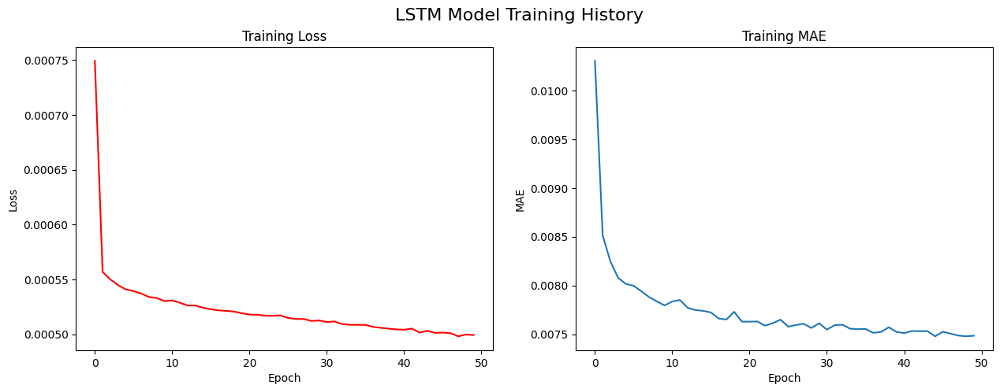

FINAL LOSS: 0.000499 | FINAL MAE: 0.007484


In [ ]:
import matplotlib.pyplot as plt

# Assuming 'lstm_history' contains your model's training history

# Plot training history
plt.rcParams["figure.figsize"] = (15, 5)
fig, axs = plt.subplots(1, 2)

axs[0].plot(lstm_history.history['loss'], color='red')
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Loss')
axs[0].set_title('Training Loss')

axs[1].plot(lstm_history.history['mae'])
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('MAE')
axs[1].set_title('Training MAE')

fig.suptitle('LSTM Model Training History', fontsize=16)
plt.show()

# Assuming the training history contains valid data
final_loss = lstm_history.history['loss'][-1]
final_mae = lstm_history.history['mae'][-1]

# Display final loss and MAE with more decimal places using f-strings
print(f"FINAL LOSS: {final_loss:.6f} | FINAL MAE: {final_mae:.6f}")


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, LSTM, Dense, Concatenate, MultiHeadAttention, Dropout, LayerNormalization
import plotly.graph_objects as go

# Load the dataset
file_path = "/content/Asthma_PM2.5_COPD_Lat_Long.csv"
data = pd.read_csv(file_path)

# Ensure 'CountyFips_Year' column exists
if 'CountyFips_Year' not in data.columns:
    data['CountyFips_Year'] = data['CountyFips'].astype(str) + "_" + data['Year'].astype(str)

# Replace 'Suppressed', '^', and NaN with NaN in relevant columns
data['COPD'] = data['COPD'].replace(['Suppressed', '^', np.nan], pd.NA)
data['Asthma'] = data['Asthma'].replace(['Suppressed', '^', np.nan], pd.NA)

# Convert columns to numeric
data['COPD'] = pd.to_numeric(data['COPD'], errors='coerce')
data['Asthma'] = pd.to_numeric(data['Asthma'], errors='coerce')

# Impute missing values in 'COPD' and 'Asthma' using the mean value by Year
data['COPD'] = data.groupby('Year')['COPD'].transform(lambda x: x.fillna(x.mean()))
data['Asthma'] = data.groupby('Year')['Asthma'].transform(lambda x: x.fillna(x.mean()))

# Select relevant columns for LSTM
features = ['PM2.5', 'Asthma', 'COPD']
data = data[['CountyFips_Year', 'Year', 'Latitude', 'Longitude', 'County'] + features]

# Normalize the data
scaler = MinMaxScaler()
data[features] = scaler.fit_transform(data[features])

# Create sequences for LSTM
def create_sequences(data, seq_length):
    sequences = []
    labels = []
    for i in range(len(data) - seq_length):
        sequence = data[i:i+seq_length]
        label = data[i+seq_length]
        sequences.append(sequence)
        labels.append(label)
    return np.array(sequences), np.array(labels)

seq_length = 3  # Example sequence length
train_data = data[data['Year'] < 2020]
test_data = data[data['Year'] == 2020]

# Create sequences for training
train_sequences, train_labels = create_sequences(train_data[features].values, seq_length)

# Create sequences for testing
test_sequences, test_labels = create_sequences(test_data[features].values, seq_length)

# Reshape sequences for LSTM (samples, time steps, features)
train_sequences = train_sequences.reshape((train_sequences.shape[0], seq_length, len(features)))
test_sequences = test_sequences.reshape((test_sequences.shape[0], seq_length, len(features)))

# Define the model with LSTM and MultiHeadAttention
input_layer = Input(shape=(seq_length, len(features)))

# MultiHeadAttention layer
attention_output = MultiHeadAttention(num_heads=2, key_dim=2)(input_layer, input_layer)
attention_output = Dropout(0.1)(attention_output)
attention_output = LayerNormalization(epsilon=1e-6)(attention_output)

# Concatenate the attention output with the input
concatenated_output = Concatenate()([input_layer, attention_output])

# LSTM layer
lstm_output = LSTM(50, activation='relu')(concatenated_output)

# Dense output layer
output_layer = Dense(len(features))(lstm_output)

# Define the model
model = Model(inputs=input_layer, outputs=output_layer)

# Compile the model
model.compile(optimizer='adam', loss='mse', metrics=['mae'])

model.summary()

# Train the model
lstm_history_with_Transformer = model.fit(
    train_sequences,
    train_labels,
    epochs=50,
    verbose=1
)

# Predict on the test data
predictions = model.predict(test_sequences)

# Inverse transform the predictions and test labels
predictions = scaler.inverse_transform(predictions)
test_labels = scaler.inverse_transform(test_labels)

# Calculate MAE and MSE
mae_pm25 = mean_absolute_error(test_labels[:, 0], predictions[:, 0])
mse_pm25 = mean_squared_error(test_labels[:, 0], predictions[:, 0])
mae_asthma = mean_absolute_error(test_labels[:, 1], predictions[:, 1])
mse_asthma = mean_squared_error(test_labels[:, 1], predictions[:, 1])
mae_copd = mean_absolute_error(test_labels[:, 2], predictions[:, 2])
mse_copd = mean_squared_error(test_labels[:, 2], predictions[:, 2])

print(f"Mean Absolute Error (PM2.5): {mae_pm25}")
print(f"Mean Squared Error (PM2.5): {mse_pm25}")
print(f"Mean Absolute Error (Asthma): {mae_asthma}")
print(f"Mean Squared Error (Asthma): {mse_asthma}")
print(f"Mean Absolute Error (COPD): {mae_copd}")
print(f"Mean Squared Error (COPD): {mse_copd}")

# Extract latitude, longitude, and names for the test data
test_data_with_lat_lon = data[data['Year'] == 2020]
parish_latitudes = test_data_with_lat_lon['Latitude'].values
parish_longitudes = test_data_with_lat_lon['Longitude'].values
parish_names = test_data_with_lat_lon['County'].values

# Plot the actual test values for PM2.5, Asthma, and COPD
fig_actual = go.Figure()

fig_actual.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=test_labels[:, 0],  # Actual PM2.5 values
        colorscale='Viridis',
        colorbar=dict(title='Actual PM2.5 Values'),
    ),
    text=parish_names,
    name='Actual PM2.5'
))

fig_actual.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=test_labels[:, 1],  # Actual Asthma values
        colorscale='Reds',
        colorbar=dict(title='Actual Asthma Values'),
    ),
    text=parish_names,
    name='Actual Asthma'
))

fig_actual.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=test_labels[:, 2],  # Actual COPD values
        colorscale='Blues',
        colorbar=dict(title='Actual COPD Values'),
    ),
    text=parish_names,
    name='Actual COPD'
))

fig_actual.update_layout(
    title='Actual PM2.5, Asthma, and COPD Values for Parishes in 2020',
    mapbox=dict(
        style='carto-positron',
        zoom=5,
        center=dict(lat=30.4583, lon=-91.1403),
    ),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=["visible", [True, False, False]],
                    label="PM2.5",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, True, False]],
                    label="Asthma",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, False, True]],
                    label="COPD",
                    method="restyle"
                ),
                dict(
                    args=["visible", [True, True, True]],
                    label="All",
                    method="restyle"
                )
            ]),
            direction="down",
            showactive=True
        )
    ]
)

# Plot the predicted values for PM2.5, Asthma, and COPD
fig_predicted = go.Figure()

fig_predicted.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=predictions[:, 0],  # Predicted PM2.5 values
        colorscale='Viridis',
        colorbar=dict(title='Predicted PM2.5 Values'),
    ),
    text=parish_names,
    name='Predicted PM2.5'
))

fig_predicted.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=predictions[:, 1],  # Predicted Asthma values
        colorscale='Reds',
        colorbar=dict(title='Predicted Asthma Values'),
    ),
    text=parish_names,
    name='Predicted Asthma'
))

fig_predicted.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=predictions[:, 2],  # Predicted COPD values
        colorscale='Blues',
        colorbar=dict(title='Predicted COPD Values'),
    ),
    text=parish_names,
    name='Predicted COPD'
))

fig_predicted.update_layout(
    title='Predicted PM2.5, Asthma, and COPD Values for Parishes in 2020',
    mapbox=dict(
        style='carto-positron',
        zoom=5,
        center=dict(lat=30.4583, lon=-91.1403),
    ),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=["visible", [True, False, False]],
                    label="PM2.5",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, True, False]],
                    label="Asthma",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, False, True]],
                    label="COPD",
                    method="restyle"
                ),
                dict(
                    args=["visible", [True, True, True]],
                    label="All",
                    method="restyle"
                )
            ]),
            direction="down",
            showactive=True
        )
    ]
)

# Display both plots
fig_actual.show()
fig_predicted.show()


<ipython-input-15-57b7c9428bd6>:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 3, 3)]               0         []                            
                                                                                                  
 multi_head_attention (Mult  (None, 3, 3)                 63        ['input_1[0][0]',             
 iHeadAttention)                                                     'input_1[0][0]']             
                                                                                                  
 dropout (Dropout)           (None, 3, 3)                 0         ['multi_head_attention[0][0]']
                                                                                                  
 layer_normalization (Layer  (None, 3, 3)                 6         ['dropout[0][0]']         

In [ ]:
# Plot the actual test values for PM2.5, Asthma, and COPD with variable circle sizes
fig_actual = go.Figure()

# Define function to calculate circle sizes based on values
def calculate_circle_sizes(values):
    # Scale the values to a range suitable for circle sizes
    scaled_values = (values - np.min(values)) / (np.max(values) - np.min(values))
    # Define a minimum and maximum size for circles
    min_size = 5  # Adjust as needed
    max_size = 20  # Adjust as needed
    # Calculate circle sizes based on scaled values
    sizes = min_size + (max_size - min_size) * scaled_values
    return sizes

fig_actual.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=calculate_circle_sizes(test_labels[:, 0]),  # Actual PM2.5 values
        color=test_labels[:, 0],  # Actual PM2.5 values
        colorscale='Viridis',
        colorbar=dict(title='Actual PM2.5 Values'),
    ),
    text=parish_names,
    name='Actual PM2.5'
))

fig_actual.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=calculate_circle_sizes(test_labels[:, 1]),  # Actual Asthma values
        color=test_labels[:, 1],  # Actual Asthma values
        colorscale='magma',
        colorbar=dict(title='Actual Asthma Values'),
    ),
    text=parish_names,
    name='Actual Asthma'
))

fig_actual.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=calculate_circle_sizes(test_labels[:, 2]),  # Actual COPD values
        color=test_labels[:, 2],  # Actual COPD values
        colorscale='Plasma',
        colorbar=dict(title='Actual COPD Values'),
    ),
    text=parish_names,
    name='Actual COPD'
))

fig_actual.update_layout(
    title='Actual PM2.5, Asthma, and COPD Values for Parishes in 2020',
    mapbox=dict(
        style='carto-positron',
        zoom=5,
        center=dict(lat=30.4583, lon=-91.1403),
    ),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=["visible", [True, False, False]],
                    label="PM2.5",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, True, False]],
                    label="Asthma",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, False, True]],
                    label="COPD",
                    method="restyle"
                ),
                dict(
                    args=["visible", [True, True, True]],
                    label="All",
                    method="restyle"
                )
            ]),
            direction="down",
            showactive=True
        )
    ]
)

fig_actual.show()

fig_predicted = go.Figure()
fig_predicted.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=calculate_circle_sizes(predictions[:, 0]),  # Predicted PM2.5 values
        color=predictions[:, 0],  # Predicted PM2.5 values
        colorscale='Viridis',
        colorbar=dict(title='Predicted PM2.5 Values'),
    ),
    text=parish_names,
    name='Predicted PM2.5'
))

fig_predicted.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=calculate_circle_sizes(predictions[:, 1]),  # Predicted Asthma values
        color=predictions[:, 1],  # Predicted Asthma values
        colorscale='magma',
        colorbar=dict(title='Predicted Asthma Values'),
    ),
    text=parish_names,
    name='Predicted Asthma'
))

fig_predicted.add_trace(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=calculate_circle_sizes(predictions[:, 2]),  # Predicted COPD values
        color=predictions[:, 2],  # Predicted COPD values
        colorscale='Plasma',
        colorbar=dict(title='Predicted COPD Values'),
    ),
    text=parish_names,
    name='Predicted COPD'
))

fig_predicted.update_layout(
    title='Predicted PM2.5, Asthma, and COPD Values for Parishes in 2020',
    mapbox=dict(
        style='carto-positron',
        zoom=5,
        center=dict(lat=30.4583, lon=-91.1403),
    ),
    updatemenus=[
        dict(
            buttons=list([
                dict(
                    args=["visible", [True, False, False]],
                    label="PM2.5",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, True, False]],
                    label="Asthma",
                    method="restyle"
                ),
                dict(
                    args=["visible", [False, False, True]],
                    label="COPD",
                    method="restyle"
                ),
                dict(
                    args=["visible", [True, True, True]],
                    label="All",
                    method="restyle"
                )
            ]),
            direction="down",
            showactive=True
        )
    ]
)

fig_predicted.show()


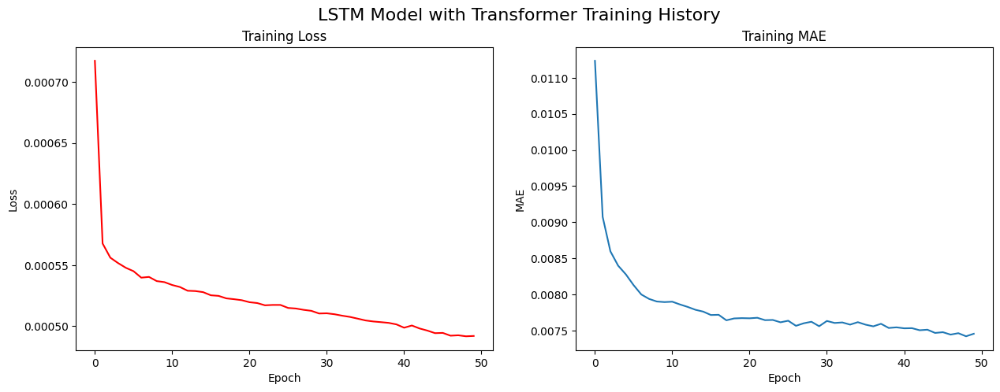

{'loss': [0.0007173519697971642, 0.0005677342414855957, 0.0005561047582887113, 0.0005517009412869811, 0.0005478484090417624, 0.0005450430908240378, 0.000539757835213095, 0.000540349050424993, 0.000536941341124475, 0.0005360778886824846, 0.0005337325856089592, 0.0005320931668393314, 0.000529034819919616, 0.0005287779495120049, 0.0005278876633383334, 0.0005253179697319865, 0.0005248338566161692, 0.0005227858200669289, 0.0005221174214966595, 0.0005212841206230223, 0.0005196506390348077, 0.0005189524381421506, 0.0005171106313355267, 0.0005174100515432656, 0.0005174065590836108, 0.0005149426287971437, 0.0005144810420460999, 0.0005133897066116333, 0.0005125821335241199, 0.000510398531332612, 0.0005105636082589626, 0.0005097907269373536, 0.0005085937445983291, 0.0005075932131148875, 0.0005061784759163857, 0.000504710478708148, 0.0005038760718889534, 0.0005033170455135405, 0.0005027149454690516, 0.0005014840280637145, 0.0004987548454664648, 0.000500570866279304, 0.0004981314414180815, 0.000496

In [ ]:
import matplotlib.pyplot as plt

# Assuming lstm_history_with_Transformer is already defined and contains the training history
plt.rcParams["figure.figsize"] = (15, 5)
fig, axs = plt.subplots(1, 2)

axs[0].plot(lstm_history_with_Transformer.history['loss'], color='red')
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Loss')
axs[0].set_title('Training Loss')

axs[1].plot(lstm_history_with_Transformer.history['mae'])
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('MAE')
axs[1].set_title('Training MAE')

fig.suptitle('LSTM Model with Transformer Training History', fontsize=16)
plt.show()

# Print the training history to verify contents
print(lstm_history_with_Transformer.history)

# Print the number of epochs and the last few values of loss and MAE
num_epochs = len(lstm_history_with_Transformer.history['loss'])
print(f"Number of epochs: {num_epochs}")
print("Last few values of loss: ", lstm_history_with_Transformer.history['loss'][-5:])
print("Last few values of MAE: ", lstm_history_with_Transformer.history['mae'][-5:])

# Assuming the training history contains valid data
final_loss = lstm_history_with_Transformer.history['loss'][-1]
final_mae = lstm_history_with_Transformer.history['mae'][-1]

# Display final loss and MAE with more decimal places using f-strings
print(f"FINAL LOSS: {final_loss:.6f} | FINAL MAE: {final_mae:.6f}")


# Prediction for only Louisiana State


Filtered unique Years in DataFrame 1: [2010 2011 2012 2013 2014 2015 2016 2017 2018 2019]
Filtered unique Years in DataFrame 2: [2010 2011 2012 2013 2014 2015 2016 2017 2018 2019]

Number of matching rows before merging: 540

Merged DataFrame:
  CountyFIPS_Year  County  PM2.5Value  Year CancerRate CancerCount  \
0      22001_2010  acadia         9.7  2010       78.9          54   
1      22001_2011  acadia         9.4  2011       80.9          54   
2      22003_2010   allen         9.6  2010       73.8          20   
3      22001_2012  acadia         9.5  2012       77.6          53   
4      22001_2013  acadia         9.4  2013         86          58   

   TotalPopulation COPDCount  StateFIPS      State  CountyFIPS Value  \
0            61876       246         22  Louisiana       22001    92   
1            61872       206         22  Louisiana       22001    74   
2            25704        87         22  Louisiana       22003    25   
3            62007       231         22  Louis

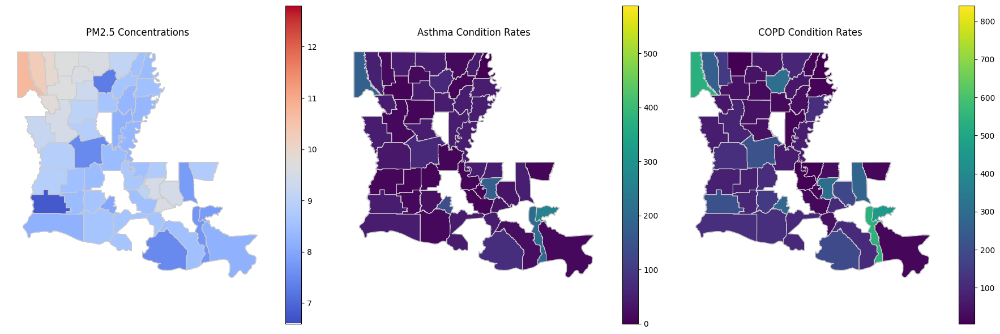

In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
import geopandas as gpd
# Load the CSV files into Pandas DataFrames
df1 = pd.read_csv('/content/PM2.5_Cancer_COPD.csv')
df2 = pd.read_csv('/content/Asthma_For_Louisiana.csv')

# Standardize the 'County' names to lowercase to ensure consistency
df1['County'] = df1['County'].str.lower().str.strip()
df2['County'] = df2['County'].str.lower().str.strip()

# Filter DataFrames to include only the overlapping years
common_years = set(df1['Year']).intersection(set(df2['Year']))
df1 = df1[df1['Year'].isin(common_years)]
df2 = df2[df2['Year'].isin(common_years)]

# Ensure the filtered DataFrames have the expected years
print("\nFiltered unique Years in DataFrame 1:", df1['Year'].unique())
print("Filtered unique Years in DataFrame 2:", df2['Year'].unique())

# Check if there are matching rows in both DataFrames before merging
matching_rows = df1.merge(df2, on=['County', 'Year'], how='inner')
print("\nNumber of matching rows before merging:", len(matching_rows))

# Merge the DataFrames based on the common columns
merged_df = pd.merge(df1, df2, on=['County', 'Year'], how='inner')

# Display the first few rows of the merged DataFrame for inspection
print("\nMerged DataFrame:")
print(merged_df.head())

# Save the merged DataFrame to a new CSV file
merged_df.to_csv('merged_file.csv', index=False)

merged_df['COPDCount'] = merged_df['COPDCount'].replace(['Suppressed', '^', np.nan], pd.NA)
merged_df['Asthma'] = merged_df['Value'].replace(['Suppressed', '^', np.nan], pd.NA)


# Convert columns to numeric
merged_df['COPDCount'] = pd.to_numeric(merged_df['COPDCount'], errors='coerce')

merged_df['Asthma'] = pd.to_numeric(merged_df['Asthma'], errors='coerce')

# Impute missing values in 'COPDCount', 'CancerCount', and 'Value' using the mean value by Year
merged_df['COPDCount'] = merged_df.groupby('Year')['COPDCount'].transform(lambda x: x.fillna(x.mean()))
merged_df['Asthma'] = merged_df.groupby('Year')['Asthma'].transform(lambda x: x.fillna(x.mean()))

# Load the shapefile containing geographic boundaries
shapefile_path = '/content/Louisiana_Parishes.shp'
gdf = gpd.read_file(shapefile_path)
gdf['Name'] = gdf['Name'].str.lower()

# Merge the geographical data with your dataset on a common identifier (e.g., parish names)
merged_data = gdf.merge(merged_df, left_on='Name', right_on='County', how='inner')

# Plot choropleth maps to visualize PM2.5 concentrations, asthma, and COPD condition rates
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))  # Changed ncols to 3

# Choropleth map for PM2.5 concentrations
merged_data.plot(column='PM2.5Value', cmap='coolwarm', linewidth=0.8, ax=axes[0], edgecolor='0.8', legend=True)
axes[0].set_title('PM2.5 Concentrations')
axes[0].set_axis_off()

# Choropleth map for asthma condition rates
merged_data.plot(column='Asthma', cmap='viridis', linewidth=0.8, ax=axes[1], edgecolor='0.8', legend=True)
axes[1].set_title('Asthma Condition Rates')
axes[1].set_axis_off()

# Choropleth map for COPD condition rates
merged_data.plot(column='COPDCount', cmap='viridis', linewidth=0.8, ax=axes[2], edgecolor='0.8', legend=True)
axes[2].set_title('COPD Condition Rates')
axes[2].set_axis_off()

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import geopandas as gpd
import plotly.express as px

# Load the CSV files into Pandas DataFrames
df1 = pd.read_csv('/content/PM2.5_Cancer_COPD.csv')
df2 = pd.read_csv('/content/Asthma_For_Louisiana.csv')

# Standardize the 'County' names to lowercase to ensure consistency
df1['County'] = df1['County'].str.lower().str.strip()
df2['County'] = df2['County'].str.lower().str.strip()

# Filter DataFrames to include only the overlapping years
common_years = set(df1['Year']).intersection(set(df2['Year']))
df1 = df1[df1['Year'].isin(common_years)]
df2 = df2[df2['Year'].isin(common_years)]

# Merge the DataFrames based on the common columns
merged_df = pd.merge(df1, df2, on=['County', 'Year'], how='inner')

# Replace 'Suppressed', '^', and NaN with NaN in relevant columns
merged_df['COPDCount'] = merged_df['COPDCount'].replace(['Suppressed', '^', np.nan], pd.NA)
merged_df['Asthma'] = merged_df['Value'].replace(['Suppressed', '^', np.nan], pd.NA)

# Convert columns to numeric
merged_df['COPDCount'] = pd.to_numeric(merged_df['COPDCount'], errors='coerce')
merged_df['Asthma'] = pd.to_numeric(merged_df['Asthma'], errors='coerce')

# Impute missing values in 'COPD' and 'Asthma' using the mean value by Year
merged_df['COPDCount'] = merged_df.groupby('Year')['COPDCount'].transform(lambda x: x.fillna(x.mean()))
merged_df['Asthma'] = merged_df.groupby('Year')['Asthma'].transform(lambda x: x.fillna(x.mean()))

# Load the shapefile containing geographic boundaries
shapefile_path = '/content/Louisiana_Parishes.shp'
gdf = gpd.read_file(shapefile_path)
gdf['Name'] = gdf['Name'].str.lower()

# Merge the geographical data with your dataset on a common identifier (e.g., parish names)
merged_data = gdf.merge(merged_df, left_on='Name', right_on='County', how='inner')

# Ensure the geometries are valid and calculate centroids
merged_data['geometry'] = merged_data['geometry'].apply(lambda geom: geom if geom.is_valid else geom.buffer(0))

# Transform the geometries to EPSG:4326 for correct latitude and longitude
merged_data = merged_data.to_crs(epsg=4326)
merged_data['centroid'] = merged_data['geometry'].centroid

# Extract latitudes and longitudes from the centroids
merged_data['latitude'] = merged_data['centroid'].apply(lambda centroid: centroid.y)
merged_data['longitude'] = merged_data['centroid'].apply(lambda centroid: centroid.x)

# Debug: Print out the first few rows to ensure centroids are correct
print(merged_data[['Name', 'latitude', 'longitude']].head())

# Create a Plotly map with circles representing PM2.5 values
fig_pm25 = px.scatter_mapbox(
    merged_data,
    lat="latitude",
    lon="longitude",
    text="Name",  # Add county names as text
    size="PM2.5Value",
    color="PM2.5Value",
    size_max=15,
    zoom=6,
    mapbox_style="carto-positron",
    title="PM2.5 Concentrations in Louisiana Parishes"
)

# Create a Plotly map with circles representing Asthma rates
fig_asthma = px.scatter_mapbox(
    merged_data,
    lat="latitude",
    lon="longitude",
    text="Name",  # Add county names as text
    size="Asthma",
    color="Asthma",
    size_max=15,
    zoom=6,
    mapbox_style="carto-positron",
    title="Asthma Condition Rates in Louisiana Parishes"
)

# Create a Plotly map with circles representing COPD rates
fig_copd = px.scatter_mapbox(
    merged_data,
    lat="latitude",
    lon="longitude",
    text="Name",  # Add county names as text
    size="COPDCount",
    color="COPDCount",
    size_max=15,
    zoom=6,
    mapbox_style="carto-positron",
    title="COPD Condition Rates in Louisiana Parishes"
)

# Display the plots
fig_pm25.show()
fig_asthma.show()
fig_copd.show()



<ipython-input-14-91fa44ec139d>:47: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




      Name  latitude  longitude
0  webster  32.71364  -93.33518
1  webster  32.71364  -93.33518
2  webster  32.71364  -93.33518
3  webster  32.71364  -93.33518
4  webster  32.71364  -93.33518


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

# Load the data
data = pd.read_csv('merged_file.csv')

# Use only the necessary columns
data = data[['Year', 'County', 'Value']]




# Replace 'Suppressed', '^', and NaN with NaN in relevant columns
merged_df['COPD'] = merged_df['COPD'].replace(['Suppressed', '^', np.nan], pd.NA)
merged_df['Asthma'] = merged_df['Value'].replace(['Suppressed', '^', np.nan], pd.NA)

# Convert columns to numeric
merged_df['COPD'] = pd.to_numeric(merged_df['COPD'], errors='coerce')
merged_df['Asthma'] = pd.to_numeric(merged_df['Asthma'], errors='coerce')
# Pivot the data to have years as rows and counties as columns
data_pivot = data.pivot(index='Year', columns='County', values='Value')
# Normalize the data
scaler = MinMaxScaler()
data_normalized = scaler.fit_transform(data_pivot)
# Fill missing values (e.g., using forward fill)
data_pivot.fillna(method='ffill', inplace=True)
# Split the data into training and test sets
train_data, test_data = train_test_split(data_normalized, test_size=0.2, shuffle=False)

# Prepare the input and output sequences for LSTM
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i+seq_length]
        y = data[i+seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

seq_length = 5  # Example sequence length
X_train, y_train = create_sequences(train_data, seq_length)
X_test, y_test = create_sequences(test_data, seq_length)
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout

# Build the LSTM model
model = Sequential()
model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, X_train.shape[2])))
model.add(Dropout(0.2))
model.add(LSTM(50, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(X_train.shape[2]))

model.compile(optimizer='adam', loss='mean_squared_error')

# Train the model
history = model.fit(X_train, y_train, epochs=50, batch_size=16, validation_split=0.2)
# Make predictions
y_pred = model.predict(X_test)

# Inverse transform the predictions and the true values to get them back to the original scale
y_test_rescaled = scaler.inverse_transform(y_test)
y_pred_rescaled = scaler.inverse_transform(y_pred)
import matplotlib.pyplot as plt

# Plot actual vs predicted values for a sample county
sample_county = 'webster'  # Example county
county_index = list(data_pivot.columns).index(sample_county)

plt.figure(figsize=(14, 7))
plt.plot(y_test_rescaled[:, county_index], label='Actual')
plt.plot(y_pred_rescaled[:, county_index], label='Predicted')
plt.title(f'Asthma Rates Prediction for {sample_county.capitalize()} County')
plt.xlabel('Time')
plt.ylabel('Asthma Rates')
plt.legend()
plt.show()


Correlation Matrix:
           PM2.5      COPD    Asthma
PM2.5   1.000000  0.175628  0.184032
COPD    0.175628  1.000000  0.859258
Asthma  0.184032  0.859258  1.000000


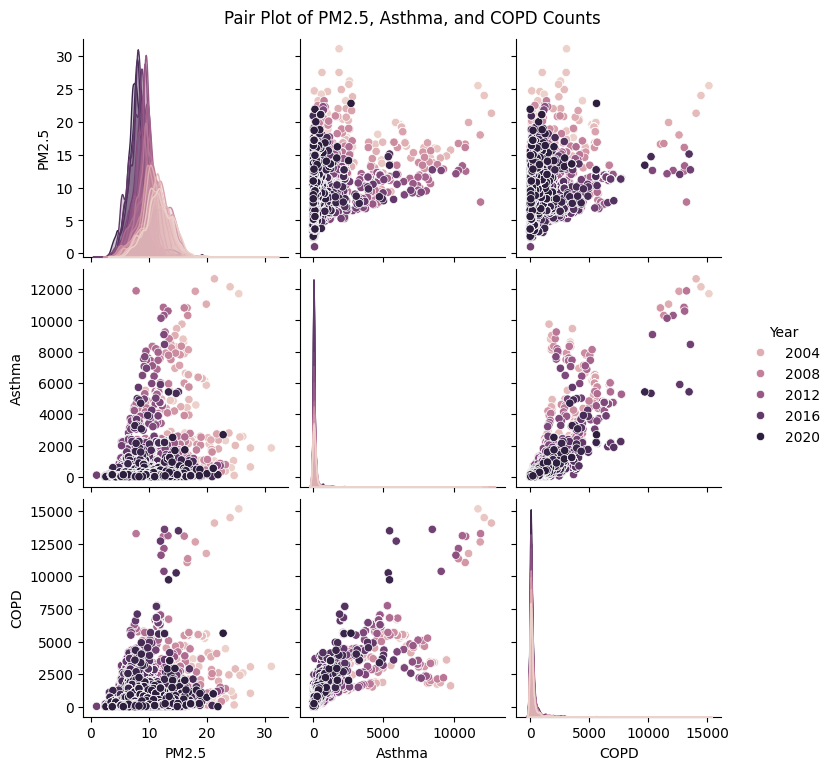

In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
data = pd.read_csv('/content/Asthma_PM2.5_COPD_Lat_Long.csv')
# Assuming merged_df is your DataFrame with columns 'CountyFIPS_Year', 'Year', 'PM2.5Value', 'CancerCount', 'COPDCount', 'TotalPopulation', 'Value'

# Replace 'Suppressed', '^', and NaN with NaN in relevant columns
data['COPD'] = data['COPD'].replace(['Suppressed', '^', np.nan], pd.NA)
data['Asthma'] = data['Asthma'].replace(['Suppressed', '^', np.nan], pd.NA)


# Convert columns to numeric
data['COPD'] = pd.to_numeric(data['COPD'], errors='coerce')
data['Asthma'] = pd.to_numeric(data['Asthma'], errors='coerce')


# Impute missing values in 'COPDCount', 'CancerCount', and 'Value' using the mean value by Year
data['COPD'] = data.groupby('Year')['COPD'].transform(lambda x: x.fillna(x.mean()))
data['Asthma'] = data.groupby('Year')['Asthma'].transform(lambda x: x.fillna(x.mean()))


# Calculate the correlations
correlation_matrix = data[['PM2.5', 'COPD', 'Asthma']].corr()
print("Correlation Matrix:")
print(correlation_matrix)

# Scatter plot to visualize the relationship between COPDCount and Asthma (Value) with bigger circles for bigger values
scatter_fig1 = px.scatter(data, x='COPD', y='Asthma', color='Year', size='COPD',
                          title='Scatter Plot of COPD Count vs. Asthma (Value)',
                          labels={'COPD': 'COPD Count', 'Asthma': 'Asthma ', 'size': 'Size'},
                          hover_data=['County'])
scatter_fig1.show()

# Scatter plot to visualize the relationship between PM2.5Value and Asthma (Value) with bigger circles for bigger values
scatter_fig2 = px.scatter(data, x='PM2.5', y='Asthma', color='Year', size='Asthma',
                          title='Scatter Plot of PM2.5 vs. Asthma (Value)',
                          labels={'PM2.5Value': 'PM2.5 Value', 'Value': 'Asthma ', 'size': 'Size'},
                          hover_data=['County'])
scatter_fig2.show()

# Scatter plot to visualize the relationship between PM2.5Value and COPDCount with bigger circles for bigger values
scatter_fig3 = px.scatter(data, x='PM2.5', y='COPD', color='Year', size='COPD',
                          title='Scatter Plot of PM2.5 vs. COPD Count',
                          labels={'PM2.5Value': 'PM2.5 Value', 'COPD': 'COPD ', 'size': 'Size'},
                          hover_data=['County'])
scatter_fig3.show()



data
# Line plot for PM2.5Value
pm25_fig = px.line(data, x='CountyFips_Year', y='PM2.5', color='Year', title='PM2.5Value for Each Year', hover_data=['County', 'Year'])
pm25_fig.show()

# Line plot for Asthma
asthma_fig = px.line(data, x='CountyFips_Year', y='Asthma', color='Year', title='Asthma for Each Year', hover_data=['County', 'Year'])
asthma_fig.show()

# Line plot for COPDCount
copd_fig = px.line(data, x='CountyFips_Year', y='COPD', color='Year', title='COPDCount for Each Year', hover_data=['County', 'Year'])
copd_fig.show()

# Additional pair plot to visualize relationships including PM2.5
sns.pairplot(data, vars=['PM2.5', 'Asthma', 'COPD'], hue='Year')
plt.suptitle("Pair Plot of PM2.5, Asthma, and COPD Counts", y=1.02)
plt.show()


#Higher rates of asthma, COPD, and PM2.5 levels along with their respective states

In [ ]:
import pandas as pd

# Assuming 'data' is your DataFrame containing columns 'County', 'State', 'Asthma', 'COPD', and 'PM2.5'
# Group by 'County' and 'State' and calculate the average values for asthma, COPD, and PM2.5
county_avg = data.groupby(['County', 'State'])[['Asthma', 'COPD', 'PM2.5']].mean().reset_index()

# Sort the data by average asthma, COPD, and PM2.5 values to find the counties with the highest ratings
top_asthma_counties = county_avg.sort_values('Asthma', ascending=False).head(10)
top_copd_counties = county_avg.sort_values('COPD', ascending=False).head(10)
top_pm25_counties = county_avg.sort_values('PM2.5', ascending=False).head(10)

print("Top Counties with Highest Average Asthma Rates:")
print(top_asthma_counties[['County', 'State', 'Asthma']])

print("\nTop Counties with Highest Average COPD Rates:")
print(top_copd_counties[['County', 'State', 'COPD']])

print("\nTop Counties with Highest Average PM2.5 Levels:")
print(top_pm25_counties[['County', 'State', 'PM2.5']])

# Sort the data by average asthma, COPD, and PM2.5 values to find the counties with the lowest ratings
lowest_asthma_counties = county_avg.sort_values('Asthma', ascending=True).head(10)
lowest_copd_counties = county_avg.sort_values('COPD', ascending=True).head(10)
lowest_pm25_counties = county_avg.sort_values('PM2.5', ascending=True).head(10)

print("Top Counties with Lowest Average Asthma Rates:")
print(lowest_asthma_counties[['County', 'State', 'Asthma']])

print("\nTop Counties with Lowest Average COPD Rates:")
print(lowest_copd_counties[['County', 'State', 'COPD']])

print("\nTop Counties with Lowest Average PM2.5 Levels:")
print(lowest_pm25_counties[['County', 'State', 'PM2.5']])

Top Counties with Highest Average Asthma Rates:
            County         State    Asthma
980    Los Angeles    California  9375.650
167          Bronx      New York  7387.450
865          Kings      New York  6508.300
1300  Philadelphia  Pennsylvania  6120.650
1749         Wayne      Michigan  4684.550
1372        Queens      New York  3783.950
1093    Miami-Dade       Florida  3729.350
1023      Maricopa       Arizona  3572.375
1187      New York      New York  3301.850
171        Broward       Florida  2747.450

Top Counties with Highest Average COPD Rates:
            County         State        COPD
980    Los Angeles    California  12129.1500
1749         Wayne      Michigan   6110.1500
1093    Miami-Dade       Florida   5545.1500
1023      Maricopa       Arizona   4652.5625
1300  Philadelphia  Pennsylvania   4558.0000
171        Broward       Florida   3889.0000
31       Allegheny  Pennsylvania   3605.0000
865          Kings      New York   3377.9000
1314      Pinellas       Fl

In [ ]:
import plotly.express as px

# Bar plot for top counties with highest average asthma rates
top_asthma_fig = px.bar(top_asthma_counties, x='County', y='Asthma', color='State',
                        title='Top Counties with Highest Average Asthma Rates Based On the Data(2001-2019)',
                        labels={'Asthma': 'Average Asthma Rate'},
                        hover_data=['State'])
top_asthma_fig.show()

# Bar plot for top counties with highest average COPD rates
top_copd_fig = px.bar(top_copd_counties, x='County', y='COPD', color='State',
                      title='Top Counties with Highest Average COPD Rates Based On the Data(2001-2019)',
                      labels={'COPD': 'Average COPD Rate'},
                      hover_data=['State'])
top_copd_fig.show()

# Bar plot for top counties with highest average PM2.5 levels
top_pm25_fig = px.bar(top_pm25_counties, x='County', y='PM2.5', color='State',
                      title='Top Counties with Highest Average PM2.5 Levels Based On the Data(2001-2019)',
                      labels={'PM2.5': 'Average PM2.5 Level'},
                      hover_data=['State'])
top_pm25_fig.show()


# Combine top counties into a single DataFrame and melt it
top_combined = pd.concat([
    top_asthma_counties[['County', 'State', 'Asthma']].rename(columns={'Asthma': 'Value'}).assign(Metric='Asthma'),
    top_copd_counties[['County', 'State', 'COPD']].rename(columns={'COPD': 'Value'}).assign(Metric='COPD')
])

# Bar plot for top counties with highest average rates for Asthma, COPD, and PM2.5
combined_fig = px.bar(top_combined, x='County', y='Value', color='Metric', barmode='group',
                      title='Top Counties with Highest Average Rates for Asthma and COPD Based On the Data(2001-2019)',
                      labels={'Value': 'Average Rate/Level', 'Metric': 'Condition'},
                      hover_data=['State'])

combined_fig.show()

In [ ]:
# Bar plot for lowest counties with average asthma rates
lowest_asthma_fig = px.bar(lowest_asthma_counties, x='County', y='Asthma', color='State',
                           title='Top Counties with Lowest Average Asthma Rates',
                           labels={'Asthma': 'Average Asthma Rate'},
                           hover_data=['State'])
lowest_asthma_fig.show()

# Bar plot for lowest counties with average COPD rates
lowest_copd_fig = px.bar(lowest_copd_counties, x='County', y='COPD', color='State',
                         title='Top Counties with Lowest Average COPD Rates',
                         labels={'COPD': 'Average COPD Rate'},
                         hover_data=['State'])
lowest_copd_fig.show()

# Bar plot for lowest counties with average PM2.5 levels
lowest_pm25_fig = px.bar(lowest_pm25_counties, x='County', y='PM2.5', color='State',
                         title='Top Counties with Lowest Average PM2.5 Levels',
                         labels={'PM2.5': 'Average PM2.5 Level'},
                         hover_data=['State'])
lowest_pm25_fig.show()
# Combine lowest counties into a single DataFrame and melt it
lowest_combined = pd.concat([
    lowest_asthma_counties[['County', 'State', 'Asthma']].rename(columns={'Asthma': 'Value'}).assign(Metric='Asthma'),
    lowest_copd_counties[['County', 'State', 'COPD']].rename(columns={'COPD': 'Value'}).assign(Metric='COPD'),
    lowest_pm25_counties[['County', 'State', 'PM2.5']].rename(columns={'PM2.5': 'Value'}).assign(Metric='PM2.5')
])

# Bar plot for lowest counties with lowest average rates for Asthma, COPD, and PM2.5
combined_lowest_fig = px.bar(lowest_combined, x='County', y='Value', color='Metric', barmode='group',
                             title='Top Counties with Lowest Average Rates for Asthma, COPD, and PM2.5 Based On the Data(2001-2019)',
                             labels={'Value': 'Average Rate/Level', 'Metric': 'Condition'},
                             hover_data=['State'])

combined_lowest_fig.show()


In [ ]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# Load the shapefile containing geographic boundaries
shapefile_path = '/content/Louisiana_Parishes.shp'
gdf = gpd.read_file(shapefile_path)
gdf['Name'] = gdf['Name'].str.lower()
merged_df = pd.read_csv('/content/Asthma_PM2.5_COPD_Lat_Long.csv')
# Merge the geographical data with your dataset on a common identifier (e.g., parish names)
merged_data = gdf.merge(merged_df, left_on='Name', right_on='County', how='inner')

# Plot choropleth maps to visualize PM2.5 concentrations, asthma, and COPD condition rates
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))  # Changed ncols to 3

# Choropleth map for PM2.5 concentrations
merged_data.plot(column='PM2.5', cmap='coolwarm', linewidth=0.8, ax=axes[0], edgecolor='0.8', legend=True)
axes[0].set_title('PM2.5 Concentrations')
axes[0].set_axis_off()

# Choropleth map for asthma condition rates
merged_data.plot(column='Asthma', cmap='viridis', linewidth=0.8, ax=axes[1], edgecolor='0.8', legend=True)
axes[1].set_title('Asthma Condition Rates')
axes[1].set_axis_off()

# Choropleth map for COPD condition rates
merged_data.plot(column='COPD', cmap='viridis', linewidth=0.8, ax=axes[2], edgecolor='0.8', legend=True)
axes[2].set_title('COPD Condition Rates')
axes[2].set_axis_off()

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
import plotly.graph_objects as go

# Load PM2.5 data
pm25_file = '/content/Monthly_PM25_Values_2011_2021.csv'
pm25_data = pd.read_csv(pm25_file)

# Split the 'Date' column into 'Year' and 'Month' columns
pm25_data[['Year', 'Month']] = pm25_data['Date'].str.split('/', expand=True)
# Check for missing values in the 'Year' column
missing_values = pm25_data['Year'].isnull().sum()
if missing_values > 0:
    print("There are missing values in the 'Year' column.")
# Drop rows with missing values in the 'Year' column
pm25_data.dropna(subset=['Year'], inplace=True)
# Recalculate last_date_year after handling missing values
last_date_index = pm25_data.index[-1]
last_date_year = int(pm25_data.loc[last_date_index, 'Year'])

# Preprocess data for LSTM
pm25_values = pm25_data['PM2.5'].values.reshape(-1, 1)  # 'PM2.5' column contains mean PM2.5 values
scaler = MinMaxScaler(feature_range=(0, 1))
pm25_scaled = scaler.fit_transform(pm25_values)
#PM2.5 Data: [10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65]
#if time steps 3
#X = [[10, 15, 20], [15, 20, 25], [20, 25, 30], [25, 30, 35], ...]
# y = [25, 30, 35, 40, ...]

# Prepare data for LSTM (3D input)
time_steps = 10  # Define the number of time steps (adjust as needed)
X = []
y = []
for i in range(len(pm25_scaled) - time_steps):
    X.append(pm25_scaled[i:i+time_steps, 0])
    y.append(pm25_scaled[i+time_steps, 0])

X = np.array(X)
y = np.array(y)

# Reshape data for LSTM (samples, time steps, features)
X = np.reshape(X, (X.shape[0], X.shape[1], 1))

# Define and compile the LSTM model
model = Sequential()
model.add(LSTM(units=50, return_sequences=True, input_shape=(X.shape[1], 1)))
model.add(LSTM(units=50))
model.add(Dense(units=1))

model.compile(optimizer='adam', loss='mean_squared_error')

# Train the LSTM model
model.fit(X, y, epochs=100, batch_size=32)

# Make predictions for January 2022 (monthly predictions)
predicted_values = []
initial_sequence = X[-1]  # Initial sequence for prediction
for _ in range(1):  # Predicting for January 2022
    predicted_value = model.predict(initial_sequence.reshape(1, time_steps, 1))
    predicted_values.append(predicted_value.flatten()[0])  # Append predicted value
    initial_sequence = np.append(initial_sequence[1:], predicted_value)  # Update sequence for next prediction

# Inverse transform the predictions (if needed)
predicted_values = np.array(predicted_values).reshape(-1, 1)
predicted_values = scaler.inverse_transform(predicted_values)

# Get latitude and longitude for each parish
parish_latitudes = pm25_data['Latitude'].values
parish_longitudes = pm25_data['Longitude'].values
parish_names = pm25_data['Parish'].values  # Get parish names

# Create a Plotly scattermapbox plot for the predicted values
fig = go.Figure(go.Scattermapbox(
    lat=parish_latitudes,
    lon=parish_longitudes,
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=10,
        color=predicted_values.flatten(),  # Color based on predicted PM2.5 values
        colorscale='Viridis',  # Choose a colorscale
        colorbar=dict(title='Predicted PM2.5 Values')
    ),
    text=parish_names,  # Tooltip text (Parish names)
))

fig.update_layout(
    title='Predicted PM2.5 Values for Parishes in January 2022',
    mapbox=dict(
        style='carto-positron',
        zoom=5,
        center=dict(lat=30.4583, lon=-91.1403),  # Set the center of the map
    ),
)

fig.show()


In [ ]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
pm25_file = '/content/Asthma_PM2.5_COPD_Lat_Long.csv'
merged_df = pd.read_csv(pm25_file)

# Load the shapefile containing geographic boundaries
shapefile_path = '/content/States_shapefile.shp'
gdf = gpd.read_file(shapefile_path)

# Ensure the names are in lower case and stripped of leading/trailing whitespace
gdf['County'] = gdf['County'].str.lower().str.strip()
merged_df['County'] = merged_df['County'].str.lower().str.strip()

# Print unique values to check for discrepancies
print("Unique values in shapefile 'Name' column:", gdf['Name'].unique())
print("Unique values in CSV 'County' column:", merged_df['County'].unique())

# Merge the geographical data with your dataset on a common identifier (e.g., parish names)
merged_data = gdf.merge(merged_df, left_on='Name', right_on='County', how='inner')

# Check if the merge resulted in any rows
if merged_data.empty:
    print("Merged GeoDataFrame is empty. Check for mismatched values between 'Name' and 'County' columns.")
else:
    # Plot choropleth maps to visualize PM2.5 concentrations, asthma, and COPD condition rates
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))  # Changed ncols to 3

    # Choropleth map for PM2.5 concentrations
    merged_data.plot(column='PM2.5', cmap='coolwarm', linewidth=0.8, ax=axes[0], edgecolor='0.8', legend=True)
    axes[0].set_title('PM2.5 Concentrations')
    axes[0].set_axis_off()

    # Choropleth map for asthma condition rates
    merged_data.plot(column='Asthma', cmap='viridis', linewidth=0.8, ax=axes[1], edgecolor='0.8', legend=True)
    axes[1].set_title('Asthma Condition Rates')
    axes[1].set_axis_off()

    # Choropleth map for COPD condition rates
    merged_data.plot(column='COPD', cmap='viridis', linewidth=0.8, ax=axes[2], edgecolor='0.8', legend=True)
    axes[2].set_title('COPD Condition Rates')
    axes[2].set_axis_off()

    plt.tight_layout()
    plt.show()


#Correlation with covid

  CountyFips_Year    State_x          County_x  PM2.5 Asthma   COPD  \
0      22017_2020  Louisiana             Caddo   13.0     93  352.0   
1      22019_2020  Louisiana         Calcasieu   10.1     25  145.0   
2      22033_2020  Louisiana  East Baton Rouge   13.7    103  207.0   
3      22047_2020  Louisiana         Iberville   10.2      8   30.0   
4      22051_2020  Louisiana         Jefferson   14.6    132  384.0   

   StateFIPS    State_y          County_y  Value  Data Comment Asthma.Value  \
0         22  Louisiana             Caddo   13.0           NaN           93   
1         22  Louisiana         Calcasieu   10.1           NaN           25   
2         22  Louisiana  East Baton Rouge   13.7           NaN          103   
3         22  Louisiana         Iberville   10.2           NaN            8   
4         22  Louisiana         Jefferson   14.6           NaN          132   

   COPD.Value  Covid.CovidPositive  
0         352                26614  
1         145           

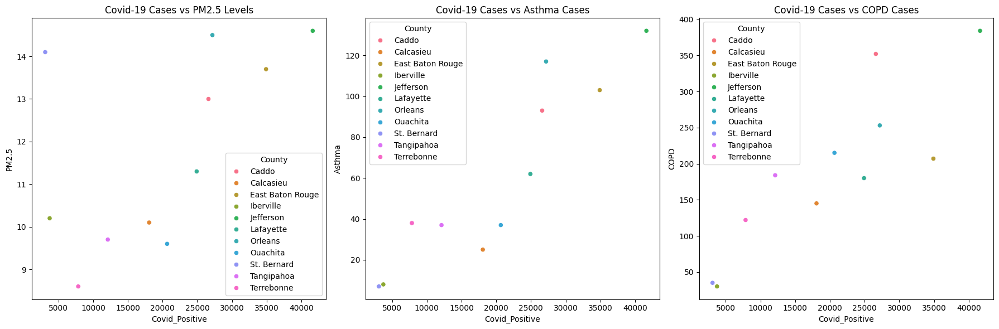

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import statsmodels.api as sm

# Load datasets
historical_data = pd.read_csv('/content/LSU_Copd_Asthma_PM2.5(2001-2019).csv')
covid_data = pd.read_csv('/content/Covid_Asthma.csv')

# Merge datasets on CountyFips_Year
combined_data = pd.merge(historical_data, covid_data, on='CountyFips_Year', how='inner')
print(combined_data.head())  # Print the first few rows to inspect the data

# Print the column names to verify
print(combined_data.columns)

# Now access the columns directly to check for existence and spelling
covid_positive = combined_data['Covid.CovidPositive']
print(covid_positive.head())  # Print the first few values to check

# Convert columns to numerical data type if needed
combined_data['Asthma'] = pd.to_numeric(combined_data['Asthma'], errors='coerce')
combined_data['COPD'] = pd.to_numeric(combined_data['COPD'], errors='coerce')
combined_data['PM2.5'] = pd.to_numeric(combined_data['PM2.5'], errors='coerce')
combined_data['Covid_Positive'] = pd.to_numeric(combined_data['Covid.CovidPositive'], errors='coerce')
combined_data['County'] = combined_data['County_x']

# Drop rows with NaN values in the columns used for correlation analysis
combined_data.dropna(subset=['Asthma', 'COPD', 'PM2.5', 'Covid.CovidPositive'], inplace=True)

# Now you can perform correlation analysis
correlation_asthma, _ = pearsonr(combined_data['Asthma'], combined_data['Covid.CovidPositive'])
print('Correlation between COVID-19 cases and Asthma:', correlation_asthma)

correlation_copd, _ = pearsonr(combined_data['COPD'], combined_data['Covid.CovidPositive'])
print('Correlation between COVID-19 cases and COPD:', correlation_copd)

correlation_pm25, _ = pearsonr(combined_data['PM2.5'], combined_data['Covid.CovidPositive'])
print('Correlation between COVID-19 cases and PM2.5 levels:', correlation_pm25)

# Create a single figure for multiple scatter plots
plt.figure(figsize=(18, 6))

# Scatter plot for COVID-19 cases vs PM2.5 levels
plt.subplot(1, 3, 1)
sns.scatterplot(data=combined_data, x='Covid_Positive', y='PM2.5', hue='County')
plt.title('Covid-19 Cases vs PM2.5 Levels')

# Scatter plot for COVID-19 cases vs Asthma
plt.subplot(1, 3, 2)
sns.scatterplot(data=combined_data, x='Covid_Positive', y='Asthma', hue='County')
plt.title('Covid-19 Cases vs Asthma Cases')

# Scatter plot for COVID-19 cases vs COPD
plt.subplot(1, 3, 3)
sns.scatterplot(data=combined_data, x='Covid_Positive', y='COPD', hue='County')
plt.title('Covid-19 Cases vs COPD Cases')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()
